In [2]:
#Analysis notebook for a fast analysis of the propagation steps

import warnings
warnings.filterwarnings("ignore")

import uproot
import awkward as ak
import numpy as np
import pandas as pd
import plotly.express as px


#using plotly as backend
pd.options.plotting.backend = "plotly"

#use pandas instead of awkward array (doesn't work?)
uproot.default_libary="pd"

In [2]:
#The input file containing the propagation steps output
inputFile="/Users/pbutti/sw/ldmx-sw/trackingGeo_v3/straight_propagator_states.root"

        entry  subentry         g_x         g_y         g_z  sensitive_id  \
0           0         0    0.000000    0.000000    0.000000             0   
1           0         1   -6.975000    2.147733    1.206548             0   
2           0         2   -7.000000    2.155431    1.210873             1   
3           0         3   -7.025000    2.163129    1.215197             0   
4           0         4  -12.975000    3.995246    2.244440             0   
...       ...       ...         ...         ...         ...           ...   
170728   9999        11 -113.000000  -18.781624   28.656790             1   
170729   9999        12 -113.025002  -18.785780   28.663130             0   
170730   9999        13 -304.420166  -50.597389   77.200920             0   
170731   9999        14 -495.815308  -82.408997  125.738716             0   
170732   9999        15 -614.500000 -102.135468  155.837143             0   

        approach_id  layer_id  
0                 0         0  
1          

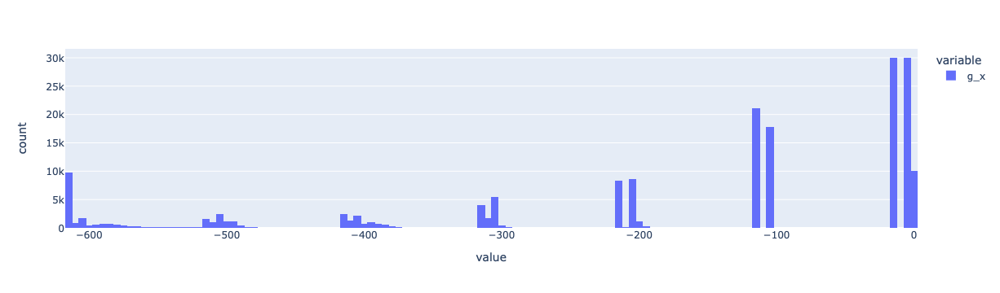

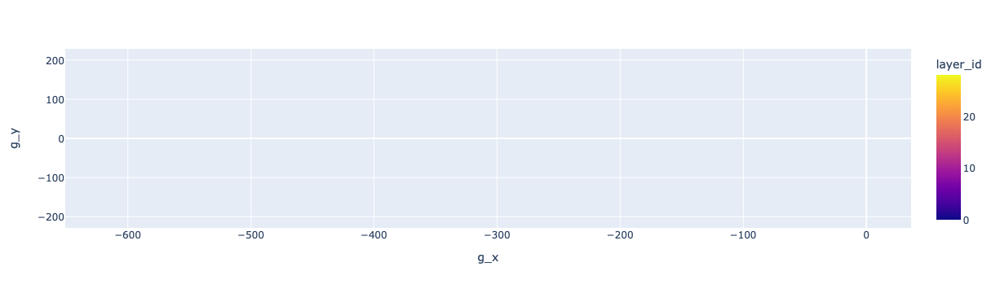

In [22]:
with uproot.open(inputFile) as infile:
    propagation_tree = infile["propagation_steps"]

    #Check the branches in the tree
    #print(propagation_tree.values())

    #Read in the X global position/direction of the steps as panda data frames
    step_position  = propagation_tree.arrays(["g_x","g_y","g_z","sensitive_id","approach_id","layer_id"],library="pd")
    step_direction = propagation_tree.arrays(["d_x","d_y","d_z"],library="pd")
    
    #print(step_position)
    #print(step_position.droplevel(level=1,axis=0))
    #make a flat df from the multi-index
    flat_step_position = step_position.reset_index()
    print(flat_step_position)
    
    #print(g_x)
    fig = step_position["g_x"].plot.hist()
    fig.show()
    
    fig = flat_step_position.plot.scatter(x="g_x",y="g_y",color="layer_id")
    fig.update_traces(marker_size = 2)
    fig.show()
    
    #fig = flat_step_position.plot.scatter(x="g_x",y="g_z",color="layer_id")
    #fig.update_traces(marker_size = 2)
    #fig.show()
    
    #fig = px.scatter_3d(flat_step_position, x='g_x', y='g_y', z='g_z', color="layer_id")
    #fig.update_layout(autosize=False,margin=dict(l=0, r=0, b=0, t=0))
    #fig.update_traces(marker_size = 2)
    #fig.show()
    